In [4]:
import numpy as np
from scipy.integrate import odeint
import pandas as pd
import warnings
pd.set_option('display.float_format', '{:0.8f}'.format)
import operator
import matplotlib as plt
from sklearn import decomposition
from dae_finder import get_der_names
from dae_finder import der_matrix_calculator
pd.set_option('display.max_rows', None)

In [5]:
# k_rates_df = pd.read_csv("parameters/k_rate_branch.csv")
k_rates_df = pd.read_csv("k_rate_branch.csv")


In [6]:
k_rates_df

,k_E1,kr_E1,kcat_E1,k_E2,kr_E2,kcat_E2,k_E3,kr_E3,kcat_E3
0,2.20000000,1.10000000,1.20000000,1.40000000,2.10000000,1.60000000,2,1.30000000,1.20000000


In [7]:
# IC_df = pd.read_csv("parameters/branch_IC.csv")
IC_df = pd.read_csv("branch_IC.csv")


In [8]:
IC_df

,A,E1,AE1,B,E2,BE2,C,E3,BE3,D
0,2.00000000,3,0,0,2,0,0,2,0,0
1,2.50000000,3,0,0,2,0,0,2,0,0
2,3.00000000,3,0,0,2,0,0,2,0,0
3,3.50000000,3,0,0,2,0,0,2,0,0
4,4.00000000,3,0,0,2,0,0,2,0,0
5,4.50000000,3,0,0,2,0,0,2,0,0
6,5.00000000,3,0,0,2,0,0,2,0,0
7,5.50000000,3,0,0,2,0,0,2,0,0
8,6.00000000,3,0,0,2,0,0,2,0,0
9,7.00000000,3,0,0,2,0,0,2,0,0


In [9]:
IC_lim = IC_df[:]
# IC_lim["E2"] = 1

In [10]:
IC_lim

,A,E1,AE1,B,E2,BE2,C,E3,BE3,D
0,2.00000000,3,0,0,2,0,0,2,0,0
1,2.50000000,3,0,0,2,0,0,2,0,0
2,3.00000000,3,0,0,2,0,0,2,0,0
3,3.50000000,3,0,0,2,0,0,2,0,0
4,4.00000000,3,0,0,2,0,0,2,0,0
5,4.50000000,3,0,0,2,0,0,2,0,0
6,5.00000000,3,0,0,2,0,0,2,0,0
7,5.50000000,3,0,0,2,0,0,2,0,0
8,6.00000000,3,0,0,2,0,0,2,0,0
9,7.00000000,3,0,0,2,0,0,2,0,0


In [11]:
from solveBranch import solveBranchMM, branchRHS, branchMMRHS, plotToyEnz

In [12]:
refinement_level = 2
final_time = 4
num_time_points = 1000
t_span = (0, final_time)
time_grid_1 = np.linspace(0, final_time, num_time_points)
data_matrix_df_list = []

def get_block_symbol(feature_list):
    return ["[{}]".format(feat) for feat in feature_list]


for k_rate_index in k_rates_df.index:
    k_rates = k_rates_df.loc[k_rate_index]
    for IC_index in IC_lim.index:
        IC = IC_lim.loc[IC_index]
        # data_matrix_df_list.append(solveMM(IC, k_rates, time_grid_1, "dense"))
        sol = solveBranchMM(IC, k_rates, time_grid_1, "dense")
        sol_df = pd.DataFrame(sol, columns=IC.keys())
        sol_df["t"] = time_grid_1
        data_matrix_df_list.append(sol_df.rename(columns=dict(zip(sol_df.columns, get_block_symbol(sol_df.columns)))))

data_matrix_df = pd.concat(data_matrix_df_list, ignore_index=True)
data_matrix_df

,[A],[E1],[AE1],[B],[E2],[BE2],[C],[E3],[BE3],[D],[t]
0,2.00000000,1.02985075,1.97014925,0.00000000,2.00000000,0.00000000,0.00000000,2.00000000,0.00000000,0.00000000,0.00000000
1,1.99054152,1.03305919,1.96694081,0.00939967,1.99291194,0.00708806,0.00002278,1.98507277,0.01492723,0.00003603,0.00400400
2,1.98109849,1.03628240,1.96371760,0.01866823,1.98597178,0.01402822,0.00009051,1.97057036,0.02942964,0.00014278,0.00800801
3,1.97167098,1.03952043,1.96047957,0.02780859,1.97917479,0.02082521,0.00020223,1.95647456,0.04352544,0.00031820,0.01201201
4,1.96225907,1.04277336,1.95722664,0.03682347,1.97251652,0.02748348,0.00035704,1.94276842,0.05723158,0.00056042,0.01601602
5,1.95286282,1.04604125,1.95395875,0.04571552,1.96599272,0.03400728,0.00055408,1.92943587,0.07056413,0.00086758,0.02002002
6,1.94348231,1.04932415,1.95067585,0.05448726,1.95959933,0.04040067,0.00079249,1.91646180,0.08353820,0.00123794,0.02402402
7,1.93411761,1.05262214,1.94737786,0.06314113,1.95333247,0.04666753,0.00107145,1.90383191,0.09616809,0.00166980,0.02802803
8,1.92476880,1.05593529,1.94406471,0.07167949,1.94718842,0.05281158,0.00139017,1.89153272,0.10846728,0.00216154,0.03203203
9,1.91543594,1.05926364,1.94073636,0.08010459,1.94116363,0.05883637,0.00174786,1.87955145,0.12044855,0.00271161,0.03603604


In [13]:
data_matrix_df.describe()

,[A],[E1],[AE1],[B],[E2],[BE2],[C],[E3],[BE3],[D],[t]
count,12000.00000000,12000.00000000,12000.00000000,12000.00000000,12000.00000000,12000.00000000,12000.00000000,12000.00000000,12000.00000000,12000.00000000,12000.00000000
mean,1.38506594,1.95948861,1.04051139,0.63004365,1.65468838,0.34531162,1.33954803,1.43286106,0.56713894,1.64534237,2.00000000
std,1.91644340,0.96806331,0.96806331,0.51783100,0.25301803,0.25301803,0.91677117,0.38354299,0.38354299,1.06976811,1.15590398
min,0.00001412,0.31221719,0.00004052,0.00000000,1.20711516,0.00000000,0.00000000,0.83725684,0.00000000,0.00000000,0.00000000
25%,0.01568681,0.96930775,0.04434888,0.11312844,1.43269719,0.08209654,0.64876517,1.08861883,0.16598354,0.82439357,1.00000000
50%,0.38393104,2.19420405,0.80579595,0.57500715,1.64261566,0.35738434,1.22926206,1.36985765,0.63014235,1.52799318,2.00000000
75%,2.19021920,2.95565112,2.03069225,1.04648792,1.91790346,0.56730281,1.95823115,1.83401646,0.91138117,2.38908936,3.00000000
max,9.00000000,2.99995948,2.68778281,1.73594156,2.00000000,0.79288484,3.98077674,2.00000000,1.16274316,4.60445407,4.00000000


Adding Noise

In [14]:
def smooth_data(data_matrix, domain_var="t", s_param=None, noise_perc=0, derr_order=1, eval_points=[]):
    assert domain_var in data_matrix, "domain variable not found in the data matrix"

    data_t = data_matrix[domain_var]
    num_time_points = len(data_matrix)
    find_s_param = s_param is None

    if len(eval_points) == 0:
        eval_points = np.linspace(data_t.iloc[0], data_t.iloc[-1], 10 * num_time_points)
    t_eval_new = eval_points

    data_matrix_ = data_matrix.drop(domain_var, axis=1)
    data_matrix_std = data_matrix_.std()

    data_matrix_smooth = pd.DataFrame(t_eval_new, columns=[domain_var])
    for feature in data_matrix_:
        if find_s_param:
            # smoothing parameter: when equal weightage: num_data_points * std of data
            s_param_ = num_time_points * (0.01 * noise_perc * data_matrix_std[feature]) ** 2
            # print(feature, s_param)
        else:
            s_param_ = s_param

        tck = interpolate.splrep(data_t, data_matrix_[feature], s=s_param_)
        # print(s_param)
        for der_ind in range(derr_order + 1):
            smoothed_data = interpolate.splev(t_eval_new, tck, der=der_ind)
            data_matrix_smooth[der_label(feature, der_ind)] = smoothed_data

    return data_matrix_smooth

In [15]:
from dae_finder import add_noise_to_df
noise_perc = 5


data_matrix_features = data_matrix_df_list[0].columns
for ind, data_matrix_ in enumerate(data_matrix_df_list):
    t_exact = data_matrix_["[t]"]
    noisy_data_df = add_noise_to_df(data_matrix_, noise_perc=noise_perc, random_seed=111)
    noisy_data_df["[t]"] = t_exact
    data_matrix_df_list[ind] = noisy_data_df

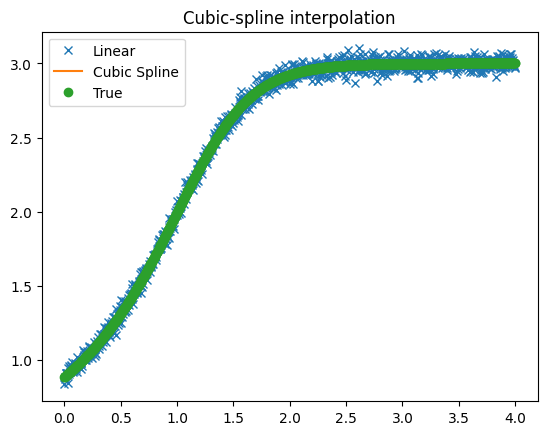

In [16]:
from scipy import interpolate
from matplotlib import pyplot as plt

#smoothing parameter: when equal weightage: num_data_points * std of data
a_param = num_time_points * (0.01*noise_perc*data_matrix_df_list[1].std()["[E1]"])**2

tck = interpolate.splrep(data_matrix_df_list[1]["[t]"], data_matrix_df_list[1]["[E1]"], s=a_param)
t_eval_new = np.linspace(t_span[0], t_span[1], 4*num_time_points)
x_new = interpolate.splev(t_eval_new, tck, der=0)

plt.figure()
plt.plot(data_matrix_df_list[1]["[t]"], data_matrix_df_list[1]["[E1]"], "x", t_eval_new, x_new,
        data_matrix_df[num_time_points:2*num_time_points]["[t]"], data_matrix_df[num_time_points:2*num_time_points]["[E1]"], "o")
plt.legend(['Linear', 'Cubic Spline', 'True'])
# plt.axis([-0.05, 6.33, -1.05, 1.05])
plt.title('Cubic-spline interpolation')
plt.show()


## Smoothing data and finding derivatives

### Sampling more from the transition region

In [17]:
num_smoothed_points = num_time_points

t_eval_new = np.linspace(data_matrix_df_list[0]["[t]"].iloc[0], data_matrix_df_list[0]["[t]"].iloc[-1], num_smoothed_points)


# amplify_left = 0.5
# amplify_right = 3.0
# amplify_factor = 1
# t_length = t_span[1] - t_span[0]

# num_left_points = int(num_smoothed_points * (amplify_left-t_span[0])/t_length)
# num_right_points = int(num_smoothed_points * (t_span[1] - amplify_right)/t_length)

# t_left = t_eval_new[:num_left_points]
# t_right = t_eval_new[-num_right_points:]
# t_middle = np.linspace(t_eval_new[num_left_points], t_eval_new[-(num_right_points+1)],
#                        amplify_factor*(len(t_eval_new) - (num_left_points + num_right_points) ))

# t_eval_new = np.concatenate((t_left, t_middle, t_right))

In [18]:
from dae_finder import smooth_data
from scipy import interpolate

# for ind in range(len(data_matrix_df_list)):
#     s_param = num_time_points * (0.01*noise_perc*data_matrix_df_list[ind].std()["[C]"])**2
#     print(ind, s_param)

#Calling the smoothening function
data_matrix_smooth_df_list = [smooth_data(data_matrix, s_param=None, domain_var="[t]",derr_order=1, noise_perc=noise_perc,
                                          eval_points=t_eval_new) for data_matrix in data_matrix_df_list]

if len(data_matrix_df_list) >1:
    data_matrix_df_smooth_appended = pd.concat(data_matrix_smooth_df_list, ignore_index=True)
else:
    data_matrix_df_smooth_appended = data_matrix_smooth_df_list[0]

data_matrix_df_smooth = data_matrix_df_smooth_appended[data_matrix_features]
if "[t]" in data_matrix_df_smooth:
    data_matrix_df_smooth = data_matrix_df_smooth.drop("[t]", axis=1)

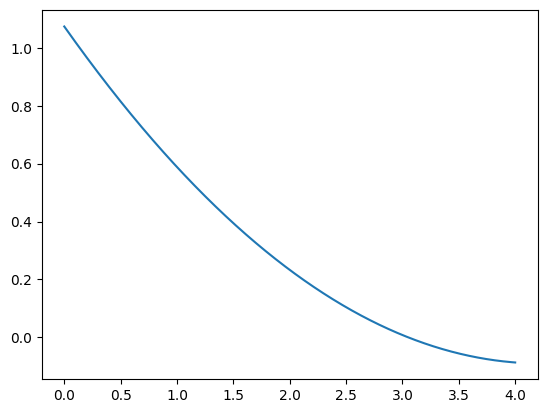

In [19]:
from scipy import interpolate


s_param = num_time_points * (0.01*noise_perc*data_matrix_df_list[ind].std()["[D]"])**2
new_df = smooth_data(data_matrix_df_list[0][["[D]", "[t]"]], s_param=s_param, domain_var="[t]",derr_order=1, noise_perc=noise_perc,
                                          eval_points=t_eval_new)

# new_df[["d([C]) /dt"]].plot()
# new_df

tck = interpolate.splrep(data_matrix_df_list[0]["[t]"], data_matrix_df_list[0]["[D]"], s=s_param)

plt.plot(t_eval_new, interpolate.splev(t_eval_new, tck, der=1))

<Axes: >

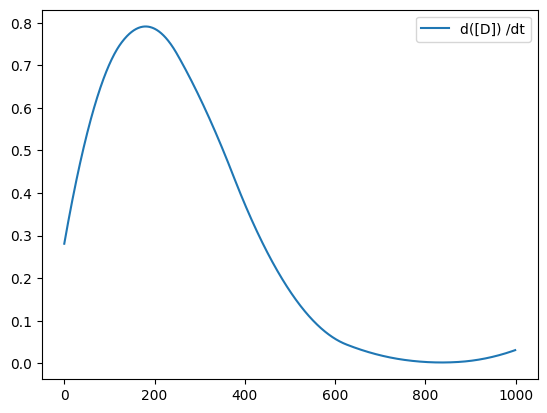

In [20]:
data_matrix_smooth_df_list[0][["d([D]) /dt"]].plot()

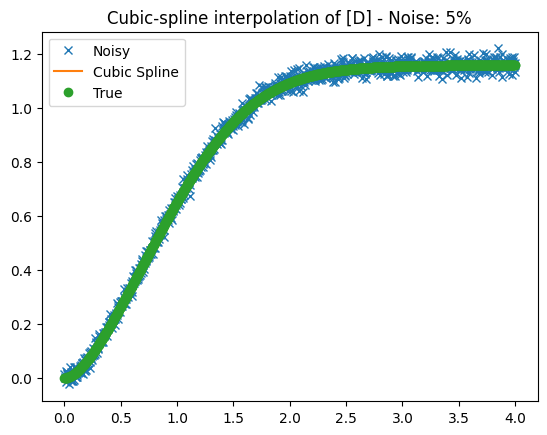

In [21]:

ind = 0
feature_ = "[D]"

plt.figure()
# plt.plot(data_matrix_df_list[1]["t"], data_matrix_df_list[1]["x"], "x", t_eval_new, x_new,
#         data_matrix_df[50:100]["t"], data_matrix_df[50:100]["x"], "o")

plt.plot(data_matrix_df_list[ind]["[t]"], data_matrix_df_list[ind][feature_], "x", data_matrix_smooth_df_list[ind]["[t]"],
         data_matrix_smooth_df_list[ind][feature_],data_matrix_df[ind*num_time_points:(ind+1)*num_time_points]["[t]"], data_matrix_df[ind*num_time_points:(ind+1)*num_time_points][feature_], "o")
plt.legend(['Noisy', 'Cubic Spline', 'True'])
# plt.axis([-0.05, 6.33, -1.05, 1.05])
plt.title('Cubic-spline interpolation of {} - Noise: {}%'.format(feature_, noise_perc))
plt.show()

In [23]:
# data_matrix_df_smooth

In [24]:
# data_matrix_df_smooth_appended

<Axes: >

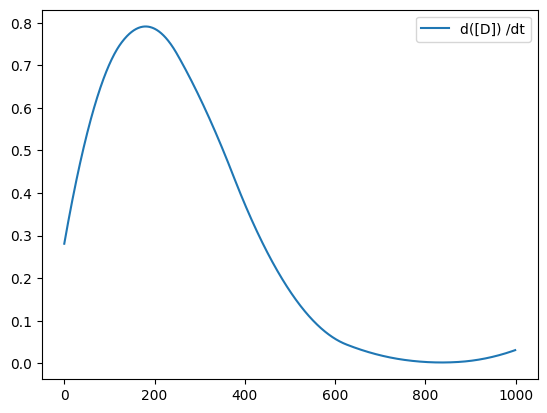

In [25]:
data_matrix_smooth_df_list[0][["d([D]) /dt"]].plot()

<Axes: >

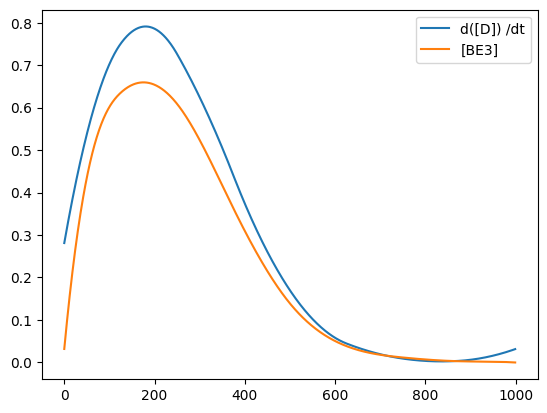

In [26]:
data_matrix_df_smooth_appended[:num_time_points][["d([D]) /dt", "[BE3]"]].plot()

In [27]:
from sklearn.linear_model import LinearRegression

mod = LinearRegression()
mod.fit(data_matrix_df_smooth_appended[["d([D]) /dt"]], data_matrix_df_smooth_appended["[E3]"])

LinearRegression()

In [28]:
mod.score(data_matrix_df_smooth_appended[["d([D]) /dt"]], data_matrix_df_smooth_appended["[E3]"])

0.9808711238345701

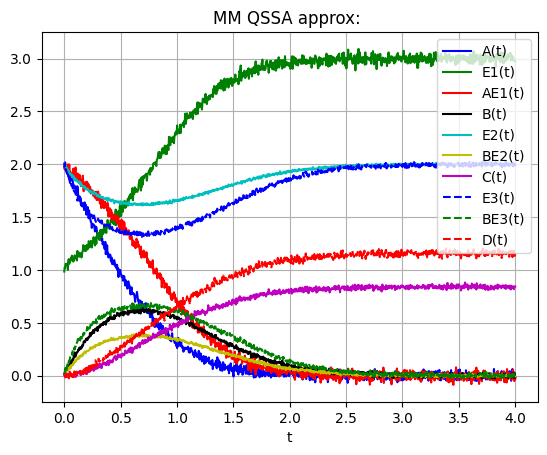

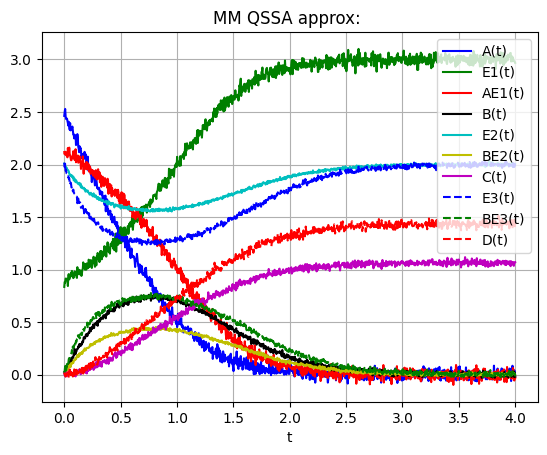

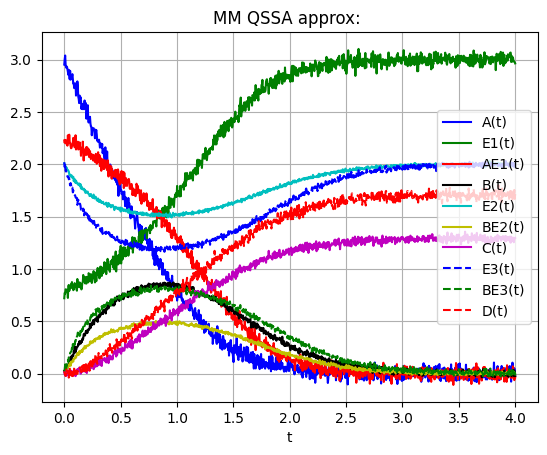

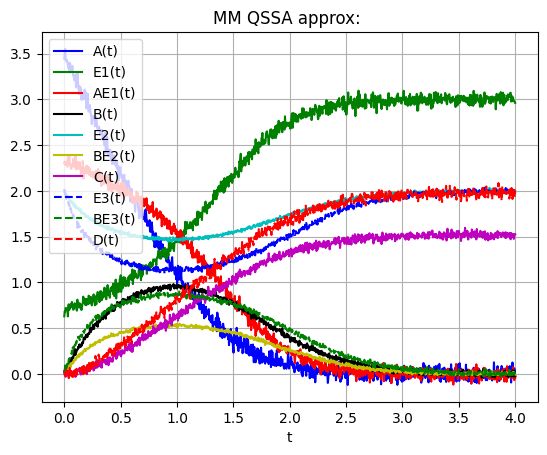

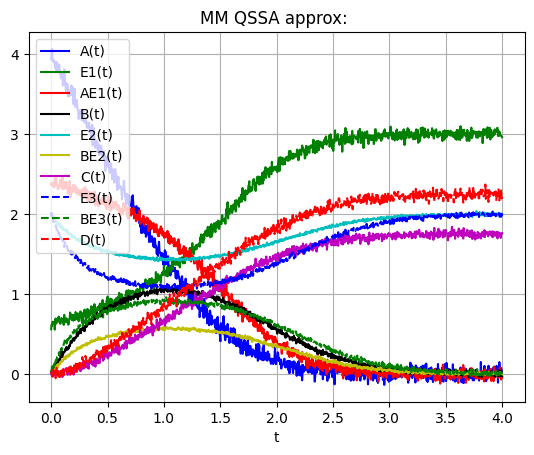

...

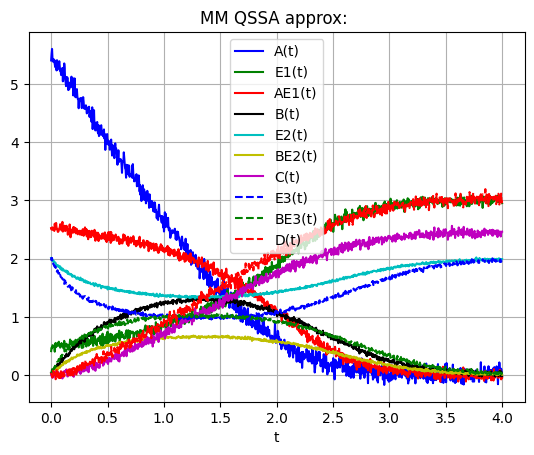

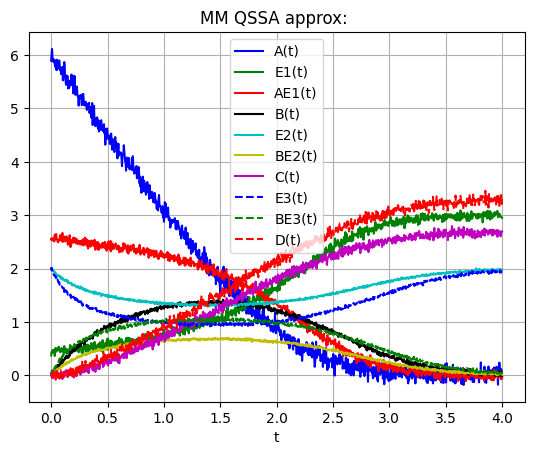

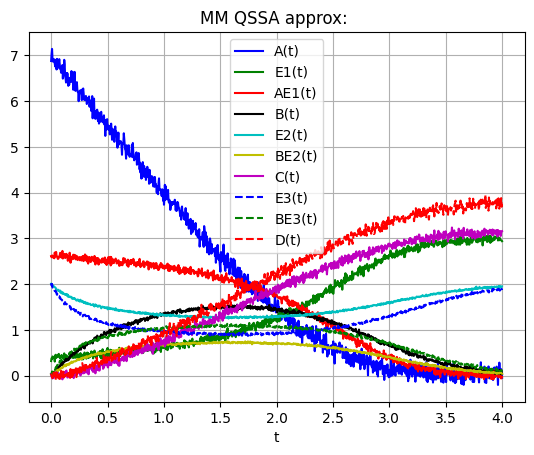

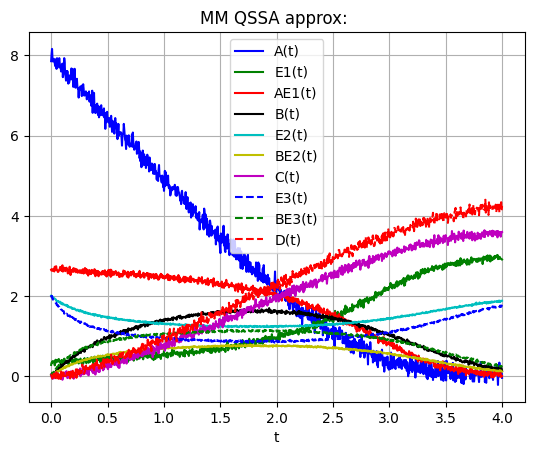

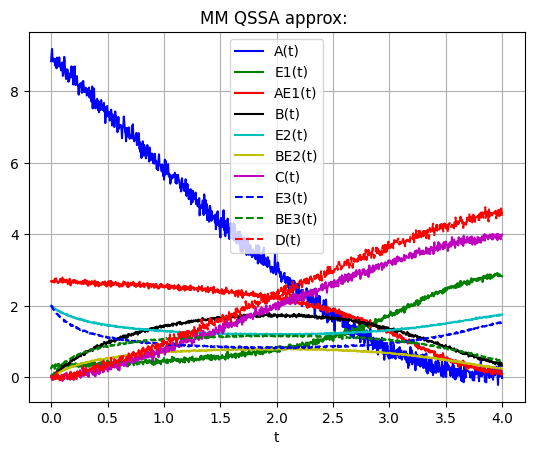

In [29]:
for sol_ in data_matrix_df_list:
    plotToyEnz(time_grid_1, sol_.to_numpy(), "MM QSSA approx: ") 

### Scaling the candidate library

In [30]:
from dae_finder import PolyFeatureMatrix

poly_feature_ob = PolyFeatureMatrix(1)

candidate_lib_full = poly_feature_ob.fit_transform(data_matrix_df_smooth)

# candidate_lib_full = candidate_lib_full.sample(frac=1).reset_index(drop=True)

In [27]:
candidate_lib_full

,1,[A],[E1],[AE1],[B],[E2],[BE2],[C],[E3],[BE3],[D]
0,1.00000000,2.00146331,1.03649842,1.96771361,0.01413070,1.98231988,0.00614044,0.00620061,1.99361118,0.03149663,-0.01568129
1,1.00000000,1.99182845,1.03952350,1.96537480,0.02219373,1.97683829,0.01233369,0.00587814,1.98050353,0.04270139,-0.01454418
2,1.00000000,1.98221340,1.04256871,1.96299419,0.03019208,1.97141253,0.01844841,0.00561018,1.96762237,0.05376235,-0.01338301
3,1.00000000,1.97261820,1.04563405,1.96057203,0.03812593,1.96604232,0.02448521,0.00539602,1.95496511,0.06468051,-0.01219794
4,1.00000000,1.96304288,1.04871949,1.95810855,0.04599549,1.96072736,0.03044471,0.00523493,1.94252917,0.07545687,-0.01098911
5,1.00000000,1.95348750,1.05182502,1.95560399,0.05380098,1.95546736,0.03632755,0.00512621,1.93031195,0.08609242,-0.00975666
6,1.00000000,1.94395208,1.05495061,1.95305860,0.06154259,1.95026202,0.04213434,0.00506915,1.91831089,0.09658816,-0.00850075
7,1.00000000,1.93443668,1.05809625,1.95047263,0.06922054,1.94511105,0.04786571,0.00506305,1.90652338,0.10694510,-0.00722151
8,1.00000000,1.92494132,1.06126192,1.94784630,0.07683501,1.94001416,0.05352228,0.00510718,1.89494685,0.11716422,-0.00591911
9,1.00000000,1.91546606,1.06444760,1.94517986,0.08438622,1.93497105,0.05910467,0.00520084,1.88357871,0.12724654,-0.00459367


In [31]:
from sklearn.model_selection import train_test_split
# candidate_lib, candidate_lib_test = train_test_split(candidate_lib_full, test_size=0.25, random_state= 22)
candidate_lib = candidate_lib_full

candidate_lib = candidate_lib.drop(labels='1', axis=1)
# candidate_lib_test = candidate_lib_test.drop(labels='1', axis = 1)

from sklearn.preprocessing import StandardScaler
s_scaler = StandardScaler(with_std=True, with_mean=False)
scaled_cand_lib = pd.DataFrame(s_scaler.fit_transform(candidate_lib), columns=s_scaler.feature_names_in_)
# scaled_cand_lib_test= pd.DataFrame(s_scaler.transform(candidate_lib_test), columns=s_scaler.feature_names_in_)
if '1' in scaled_cand_lib.columns:
        scaled_cand_lib['1'] = 1

In [32]:
from dae_finder import AlgModelFinder

In [33]:
#sing_values = pca_2.singular_values_

In [34]:
from matplotlib import pyplot as plt

#plt.plot(sing_values, 'o')

In [32]:
candidate_lib

,[A],[E1],[AE1],[B],[E2],[BE2],[C],[E3],[BE3],[D]
0,2.00146331,1.03649842,1.96771361,0.01413070,1.98231988,0.00614044,0.00620061,1.99361118,0.03149663,-0.01568129
1,1.99182845,1.03952350,1.96537480,0.02219373,1.97683829,0.01233369,0.00587814,1.98050353,0.04270139,-0.01454418
2,1.98221340,1.04256871,1.96299419,0.03019208,1.97141253,0.01844841,0.00561018,1.96762237,0.05376235,-0.01338301
3,1.97261820,1.04563405,1.96057203,0.03812593,1.96604232,0.02448521,0.00539602,1.95496511,0.06468051,-0.01219794
4,1.96304288,1.04871949,1.95810855,0.04599549,1.96072736,0.03044471,0.00523493,1.94252917,0.07545687,-0.01098911
5,1.95348750,1.05182502,1.95560399,0.05380098,1.95546736,0.03632755,0.00512621,1.93031195,0.08609242,-0.00975666
6,1.94395208,1.05495061,1.95305860,0.06154259,1.95026202,0.04213434,0.00506915,1.91831089,0.09658816,-0.00850075
7,1.93443668,1.05809625,1.95047263,0.06922054,1.94511105,0.04786571,0.00506305,1.90652338,0.10694510,-0.00722151
8,1.92494132,1.06126192,1.94784630,0.07683501,1.94001416,0.05352228,0.00510718,1.89494685,0.11716422,-0.00591911
9,1.91546606,1.06444760,1.94517986,0.08438622,1.93497105,0.05910467,0.00520084,1.88357871,0.12724654,-0.00459367


# Using Sequential Thresholding

### Using sympy to find factors of redundant feature and refine the library

In [35]:
import sympy

from dae_finder import get_refined_lib, remove_paranth_from_feat

# Adding the state variables as scipy symbols
feat_list = list(data_matrix_df.columns)
feat_list_str = ", ".join(remove_paranth_from_feat(data_matrix_df.columns))
exec(feat_list_str+ "= sympy.symbols("+str(feat_list)+")")

singular values are: [285.58065724 176.07118212  79.16154299  28.33447757  19.09690097
   2.20260134   1.49903615   0.86319932   0.73624712   0.39644382]
singular value is: 0.007712711905934072
singular value is: 0.005249081535176327
singular value is: 0.0030226112919206076
singular value is: 0.002578070682330235
singular value is: 0.0013882026262005134


,5,6,7,8,9
[A],0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
[E1],0.10407916,0.00000000,0.62589168,0.30872740,0.00000000
[AE1],0.00000000,0.00000000,0.62985150,0.31212068,0.00000000
[B],0.17012958,-0.41790087,0.00000000,0.00000000,0.00000000
[E2],0.11760624,-0.63996181,0.24774016,-0.53609596,0.15259563
[BE2],-0.16404631,0.38851555,0.37760629,-0.68197927,0.00000000
[C],0.65769052,0.17992496,0.00000000,0.00000000,0.00000000
[E3],0.00000000,0.37361332,0.00000000,0.00000000,0.67154258
[BE3],0.00000000,-0.24096077,0.00000000,0.17419246,0.71165457
[D],-0.69064445,-0.18389788,0.00000000,0.00000000,0.00000000


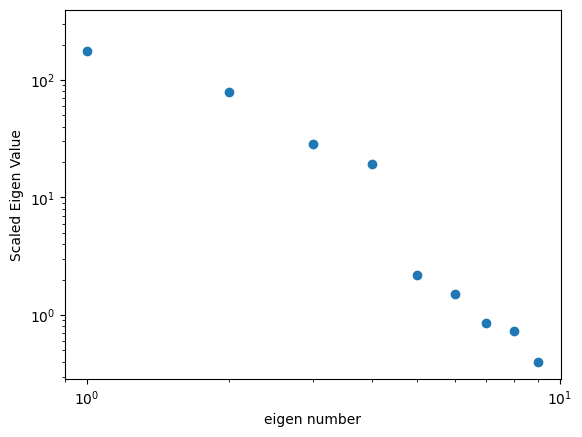

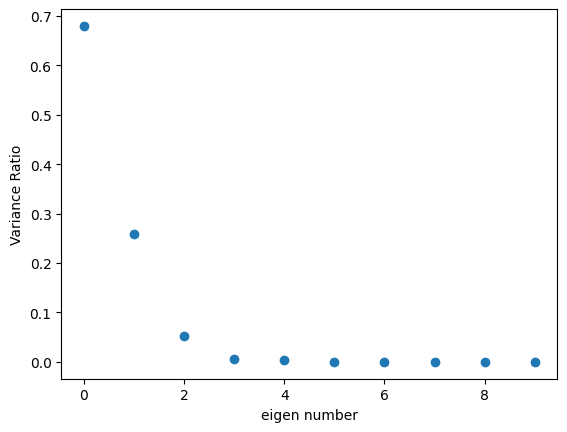

In [36]:
pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

thresh = 0.1

singular_values = pca_2.singular_values_
print("singular values are: {}".format(singular_values))
feature_names = pca_2.feature_names_in_
norm_singular_values = singular_values/singular_values[0]

alg_rel_dict = {}
for ind,sing_value in enumerate(norm_singular_values):
    if abs(sing_value) <10**-2:
        print("singular value is: {}".format(sing_value))
        pca_comp = pca_2.components_[ind]
        pca_comp[abs(pca_comp) < thresh] = 0
        alg_rel_dict[ind] = dict(zip(feature_names, pca_comp))
        alg_rel_dict[ind]["singular_value"] = sing_value
        # print(alg_rel_dict[ind])
        
alg_rel_df = pd.DataFrame(alg_rel_dict)
alg_rel_df

In [37]:
from dae_finder import sequentialThLin

seq_model_2 = sequentialThLin(model_id="EN", l1_ratio= 0.5, alpha=0.05 , coef_threshold=0.2)
# algebraic_model_Th_EN = AlgModelFinder(custom_model= True, custom_model_ob= seq_model_2, fit_intercept=True)

In [38]:
#scaled_cand_lib = scaled_cand_lib.drop('1', axis=1)

In [39]:
alg_rel_df

,5,6,7,8,9
[A],0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
[E1],0.10407916,0.00000000,0.62589168,0.30872740,0.00000000
[AE1],0.00000000,0.00000000,0.62985150,0.31212068,0.00000000
[B],0.17012958,-0.41790087,0.00000000,0.00000000,0.00000000
[E2],0.11760624,-0.63996181,0.24774016,-0.53609596,0.15259563
[BE2],-0.16404631,0.38851555,0.37760629,-0.68197927,0.00000000
[C],0.65769052,0.17992496,0.00000000,0.00000000,0.00000000
[E3],0.00000000,0.37361332,0.00000000,0.00000000,0.67154258
[BE3],0.00000000,-0.24096077,0.00000000,0.17419246,0.71165457
[D],-0.69064445,-0.18389788,0.00000000,0.00000000,0.00000000


In [40]:
alg_rel_dict_top = {}
for ind,sing_value in enumerate(norm_singular_values):
    if abs(sing_value) >10**-2:
        print("singular value is: {}".format(sing_value))
        pca_comp = pca_2.components_[ind]
        pca_comp[abs(pca_comp) < thresh] = 0
        alg_rel_dict_top[ind] = dict(zip(feature_names, pca_comp))
        alg_rel_dict_top[ind]["singular_value"] = sing_value
        # print(alg_rel_dict[ind])
        
alg_rel_top_df = pd.DataFrame(alg_rel_dict_top)
alg_rel_top_df

singular value is: 1.0
singular value is: 0.6165374918095453
singular value is: 0.2771950444805215
singular value is: 0.0992170752796312
singular value is: 0.06687042866439177


,0,1,2,3,4
[A],0.27157697,0.30874074,0.65765642,-0.63074817,0.00000000
[E1],-0.35288323,-0.19784019,-0.25759942,-0.51618162,0.00000000
[AE1],0.35249863,0.19939611,0.25850714,0.51585543,0.00000000
[B],0.35349824,-0.22202660,0.00000000,0.00000000,0.77763031
[E2],-0.35888339,0.21009642,0.13739112,0.00000000,0.00000000
[BE2],0.35849062,-0.21169712,-0.13842235,0.00000000,0.00000000
[C],-0.12778979,-0.55446198,0.42254052,0.13224252,0.00000000
[E3],-0.35815485,0.20421138,0.16170587,0.12886091,0.43170731
[BE3],0.35851175,-0.20316162,-0.15865263,-0.12070230,-0.43263724
[D],-0.14850751,-0.54508953,0.39640247,0.00000000,0.00000000


In [41]:
#Use lasso model by default
algebraic_model_1 = AlgModelFinder(fit_intercept = True, alpha = .8)
candidate_lib_lasso = candidate_lib

algebraic_model_1.fit(candidate_lib_lasso, scale_columns= True)

AlgModelFinder(alpha=0.8, fit_intercept=True)

In [42]:
#Best 10 models using R2 metrix
algebraic_model_1.best_models(5)

,[BE3],[E3],[E2],[BE2],[AE1]
[A],0.00000000,-0.00000000,-0.00000000,0.00000000,0.00000000
[E1],-0.00000000,0.00000000,0.00000000,-0.00000000,-0.20049646
[AE1],0.00000000,-0.00000000,-0.00000000,0.00000000,NaN
[B],0.00000000,-0.00000000,-0.00000000,0.00000000,0.00000000
[E2],-0.00000000,0.00000000,NaN,-0.19982557,-0.00000000
[BE2],0.00000000,-0.00000000,-0.20006009,NaN,0.00000000
[C],-0.00000000,0.00000000,0.00000000,-0.00000000,-0.00000000
[E3],-0.19961624,NaN,0.00000000,-0.00000000,-0.00000000
[D],-0.00000000,0.00000000,0.00000000,-0.00000000,-0.00000000
[BE3],NaN,-0.20033890,-0.00000000,0.00000000,0.00000000


In [43]:
features_to_remove = {AE1}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

,[BE3],[E3],[E2],[BE2],[D]
[A],0.00000000,-0.00000000,-0.00000000,0.00000000,-0.00000000
[E1],-0.00000000,0.00000000,0.00000000,-0.00000000,0.00000000
[B],0.00000000,-0.00000000,-0.00000000,0.00000000,-0.00000000
[E2],-0.00000000,0.00000000,NaN,-0.19982557,0.00000000
[BE2],0.00000000,-0.00000000,-0.20006009,NaN,-0.00000000
[C],-0.00000000,0.00000000,0.00000000,-0.00000000,0.23101057
[E3],-0.19961624,NaN,0.00000000,-0.00000000,0.00000000
[D],-0.00000000,0.00000000,0.00000000,-0.00000000,NaN
[BE3],NaN,-0.20033890,-0.00000000,0.00000000,-0.00000000
r2- metric,0.35995448,0.35995448,0.35988559,0.35988559,0.35514249


Text(0, 0.5, 'Variance Ratio')

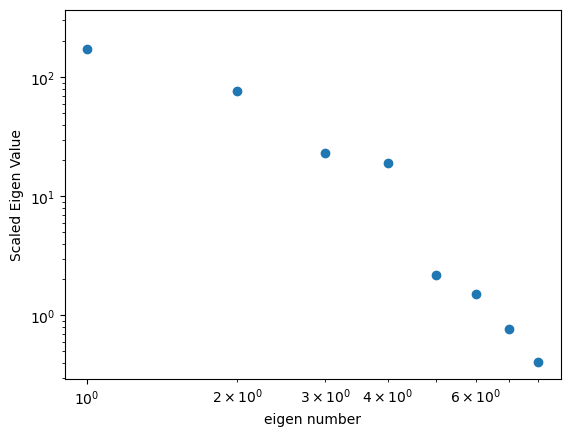

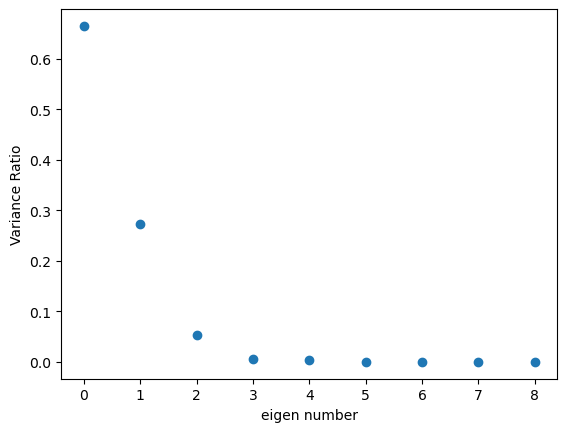

In [42]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [43]:
features_to_remove = {BE3}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)

algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

,[E2],[BE2],[C],[D],[E3]
[A],-0.00000000,0.00000000,-0.00000000,-0.00000000,-0.00000000
[E1],0.00000000,-0.00000000,0.00000000,0.00000000,0.00000000
[B],-0.00000000,0.00000000,0.00000000,-0.00000000,-0.00000000
[BE2],-0.20006009,NaN,-0.00000000,-0.00000000,-0.06741318
[C],0.00000000,-0.00000000,NaN,0.23101057,0.00000000
[E3],0.00000000,-0.00000000,0.00000000,0.00000000,NaN
[D],0.00000000,-0.00000000,0.16896728,NaN,0.00000000
[E2],NaN,-0.19982557,0.00000000,0.00000000,0.22944042
r2- metric,0.35988559,0.35988559,0.35514249,0.35514249,0.35159562


In [44]:
features_to_remove = {BE2}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)

algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

,[C],[D],[E2],[E3],[B]
[A],-0.00000000,-0.00000000,-0.00000000,-0.00000000,0.00000000
[E1],0.00000000,0.00000000,0.00000000,0.00000000,-0.00000000
[B],0.00000000,-0.00000000,-0.00533338,-0.00000000,NaN
[E2],0.00000000,0.00000000,NaN,0.29674651,-0.39184156
[E3],0.00000000,0.00000000,0.12210472,NaN,-0.00000000
[D],0.16896728,NaN,0.00000000,0.00000000,-0.00000000
[C],NaN,0.23101057,0.00000000,0.00000000,-0.00000000
r2- metric,0.35514249,0.35514249,0.35194636,0.35152034,0.34314282


In [96]:
pca_2.singular_values_

array([189.375318  , 121.74916261,  53.58408089,  16.07288135,
        13.43245586,   1.51578188,   1.20470428,   0.50908512,
         0.31646382])

Text(0, 0.5, 'Variance Ratio')

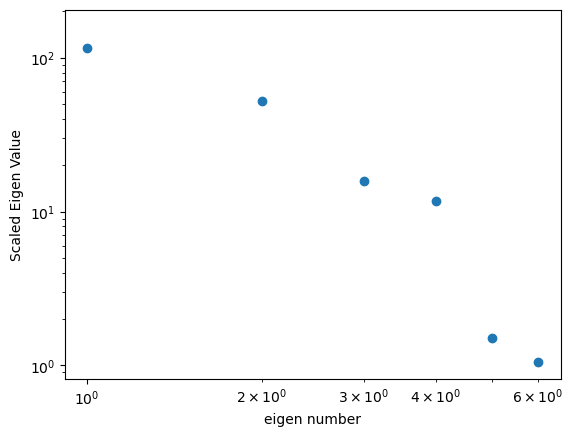

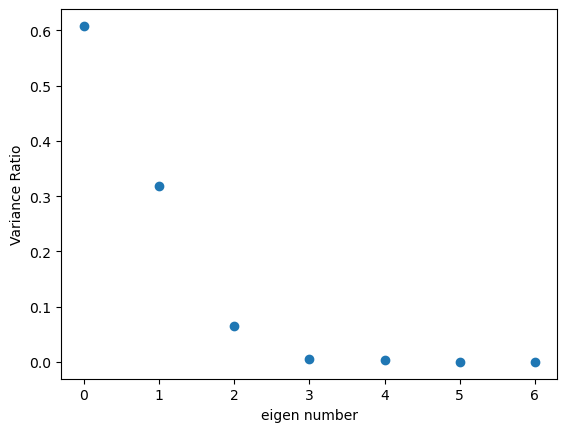

In [97]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [98]:
candidate_lib_lasso_r2

,[A],[E1],[B],[E2],[C],[E3],[D]
0,1.99281130,1.06572561,-0.00070294,1.98520687,-0.01131588,1.96499162,-0.01869506
1,1.97422943,1.06955805,0.01787336,1.97435313,-0.01001629,1.94292410,-0.01632615
2,1.95569689,1.07352872,0.03601559,1.96371749,-0.00863458,1.92144367,-0.01386402
3,1.93721484,1.07763705,0.05373079,1.95329769,-0.00717170,1.90054091,-0.01130976
4,1.91878439,1.08188251,0.07102596,1.94309142,-0.00562856,1.88020638,-0.00866443
5,1.90040671,1.08626455,0.08790814,1.93309643,-0.00400612,1.86043066,-0.00592911
6,1.88208291,1.09078263,0.10438435,1.92331041,-0.00230531,1.84120432,-0.00310487
7,1.86381415,1.09543620,0.12046161,1.91373109,-0.00052706,1.82251794,-0.00019279
8,1.84560156,1.10022473,0.13614693,1.90435618,0.00132769,1.80436208,0.00280605
9,1.82744628,1.10514766,0.15144735,1.89518341,0.00325801,1.78672732,0.00589059


In [44]:
poly_degree = 3
poly_feature_ob = PolyFeatureMatrix(poly_degree)
algebraic_model_1 = AlgModelFinder(fit_intercept = True, alpha=.9)

candidate_lib_lasso_r2 = poly_feature_ob.fit_transform(candidate_lib_lasso_r2)

#candidate_lib_lasso_r2 = candidate_lib_lasso_r2.sample(frac=1).reset_index(drop=True)

In [281]:
candidate_lib_lasso_r2

,1,[A],[E1],[B],[E2],[C],[E3],[D],[A]^2,[A] [E1],...,[C]^3,[C]^2 [E3],[C]^2 [D],[C] [E3]^2,[C] [E3] [D],[C] [D]^2,[E3]^3,[E3]^2 [D],[E3] [D]^2,[D]^3
0,1.00000000,1.99281130,1.06572561,-0.00070294,1.98520687,-0.01131588,1.96499162,-0.01869506,3.97129689,2.12379003,...,-0.00000145,0.00025162,-0.00000239,-0.04369277,0.00041570,-0.00000395,7.58721001,-0.07218520,0.00068677,-0.00000653
1,1.00000000,1.97422943,1.06955805,0.01787336,1.97435313,-0.01001629,1.94292410,-0.01632615,3.89758184,2.11155299,...,-0.00000100,0.00019493,-0.00000164,-0.03781103,0.00031772,-0.00000267,7.33444917,-0.06163045,0.00051787,-0.00000435
2,1.00000000,1.95569689,1.07352872,0.03601559,1.96371749,-0.00863458,1.92144367,-0.01386402,3.82475035,2.09949678,...,-0.00000064,0.00014326,-0.00000103,-0.03187841,0.00023002,-0.00000166,7.09386582,-0.05118522,0.00036932,-0.00000266
3,1.00000000,1.93721484,1.07763705,0.05373079,1.95329769,-0.00717170,1.90054091,-0.01130976,3.75280132,2.08761448,...,-0.00000037,0.00009775,-0.00000058,-0.02590457,0.00015415,-0.00000092,6.86485967,-0.04085147,0.00024310,-0.00000145
4,1.00000000,1.91878439,1.08188251,0.07102596,1.94309142,-0.00562856,1.88020638,-0.00866443,3.68173355,2.07589927,...,-0.00000018,0.00005957,-0.00000027,-0.01989796,0.00009169,-0.00000042,6.64686052,-0.03063028,0.00014115,-0.00000065
5,1.00000000,1.90040671,1.08626455,0.08790814,1.93309643,-0.00400612,1.86043066,-0.00592911,3.61154565,2.06434444,...,-0.00000006,0.00002986,-0.00000010,-0.01386600,0.00004419,-0.00000014,6.43932679,-0.02052184,0.00006540,-0.00000021
6,1.00000000,1.88208291,1.09078263,0.10438435,1.92331041,-0.00230531,1.84120432,-0.00310487,3.54223609,2.05294335,...,-0.00000001,0.00000978,-0.00000002,-0.00781507,0.00001318,-0.00000002,6.24174409,-0.01052561,0.00001775,-0.00000003
7,1.00000000,1.86381415,1.09543620,0.12046161,1.91373109,-0.00052706,1.82251794,-0.00019279,3.47380319,2.04168950,...,-0.00000000,0.00000051,-0.00000000,-0.00175066,0.00000019,-0.00000000,6.05362391,-0.00064037,0.00000007,-0.00000000
8,1.00000000,1.84560156,1.10022473,0.13614693,1.90435618,0.00132769,1.80436208,0.00280605,3.40624513,2.03057648,...,0.00000000,0.00000318,0.00000000,0.00432260,0.00000672,0.00000001,5.87450226,0.00913573,0.00001421,0.00000002
9,1.00000000,1.82744628,1.10514766,0.15144735,1.89518341,0.00325801,1.78672732,0.00589059,3.33955992,2.01959798,...,0.00000003,0.00001897,0.00000006,0.01040085,0.00003429,0.00000011,5.70393849,0.01880509,0.00006200,0.00000020


In [ ]:
#define a function 

fit_feature(feature):
    
    """
    """
    """
    """
    return (coef, intercepts, r_2_score)

In [ ]:
feature_result_dict = {feature: fit_feature(feature) for feature in X_scaled }


new_fitted_models = {feature: feature_result_dict[feature][0] for feature in feature_result_dict}
new_fitted_models_intercepts = {feature: feature_result_dict[feature][1] for feature in feature_result_dict}
r2_dict_score = {feature: feature_result_dict[feature][2] for feature in feature_result_dict}


In [ ]:
for i in range(100):
    calc 


fdf d {fdfd  for i in fa }

In [45]:
candidate_lib_lasso_r2 = candidate_lib_lasso_r2.drop(labels='1', axis=1)

algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

,[B] [BE2],[B]^2 [E2],[B] [E2] [BE3],[B] [BE2] [E3],[B] [BE3]
[A],0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
[E1],-0.00000000,-0.00000000,-0.00000000,-0.00000000,-0.00000000
[B],0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
[E2],-0.00000000,-0.00000000,-0.00000000,-0.00000000,-0.00000000
[BE2],0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
[C],0.00000000,0.00000000,-0.00000000,-0.00000000,0.00000000
[E3],-0.00000000,-0.00000000,-0.00000000,-0.00000000,-0.00000000
[BE3],0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
[D],-0.00000000,-0.00000000,-0.00000000,-0.00000000,-0.00000000
[A]^2,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000


Text(0, 0.5, 'Variance Ratio')

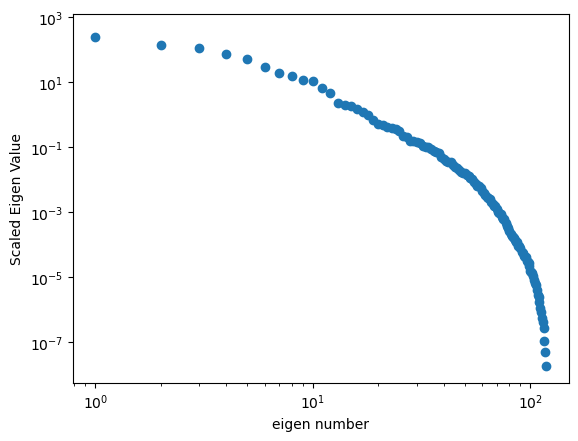

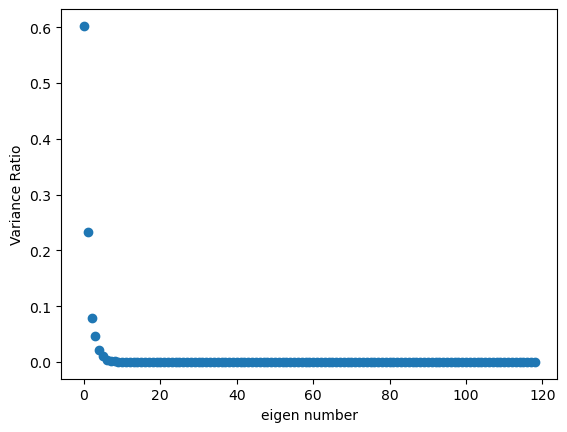

In [213]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [214]:
features_to_remove = {B*E2}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)

In [215]:
features_to_remove

{'[A] [B] [E2]',
 '[B] [E2]',
 '[B] [E2] [C]',
 '[B] [E2] [D]',
 '[B] [E2] [E3]',
 '[B] [E2]^2',
 '[B]^2 [E2]',
 '[E1] [B] [E2]'}

In [216]:
candidate_lib_lasso_r2

,[A],[E1],[B],[E2],[C],[E3],[D],[A]^2,[A] [E1],[A] [B],...,[C]^3,[C]^2 [E3],[C]^2 [D],[C] [E3]^2,[C] [E3] [D],[C] [D]^2,[E3]^3,[E3]^2 [D],[E3] [D]^2,[D]^3
0,2.00475534,1.02976065,0.00635766,1.99710670,-0.01079394,1.99413785,-0.00723329,4.01904396,2.06441816,0.01274555,...,-0.00000126,0.00023234,-0.00000084,-0.04292301,0.00015569,-0.00000056,7.92986014,-0.02876378,0.00010433,-0.00000038
1,1.97247610,1.04004184,0.03458723,1.97573329,-0.00847884,1.94955227,-0.00467821,3.89066198,2.05145768,0.06822248,...,-0.00000061,0.00014015,-0.00000034,-0.03222600,0.00007733,-0.00000019,7.40976873,-0.01778074,0.00004267,-0.00000010
2,1.94040772,1.05063686,0.06197119,1.95537088,-0.00593757,1.90773067,-0.00177452,3.76518210,2.03866387,0.12024937,...,-0.00000021,0.00006726,-0.00000006,-0.02160939,0.00002010,-0.00000002,6.94306429,-0.00645824,0.00000601,-0.00000001
3,1.90855269,1.06153107,0.08852161,1.93598576,-0.00317472,1.86855519,0.00146993,3.64257336,2.02598797,0.16894816,...,-0.00000003,0.00001883,0.00000001,-0.01108454,-0.00000872,-0.00000001,6.52405761,0.00513224,0.00000404,0.00000000
4,1.87691353,1.07270983,0.11425057,1.91754422,-0.00019493,1.83190796,0.00504723,3.52280441,2.01338359,0.21443844,...,-0.00000000,0.00000007,0.00000000,-0.00065416,-0.00000180,-0.00000000,6.14767572,0.01693793,0.00004667,0.00000013
5,1.84549277,1.08415850,0.13917014,1.90001255,0.00299720,1.79767114,0.00894952,3.40584355,2.00080667,0.25683748,...,0.00000003,0.00001615,0.00000008,0.00968580,0.00004822,0.00000024,5.80939278,0.02892145,0.00014398,0.00000072
6,1.81429290,1.09586245,0.16329238,1.88335704,0.00639704,1.76572687,0.01316891,3.29165873,1.98821546,0.29626020,...,0.00000026,0.00007226,0.00000054,0.01994462,0.00014875,0.00000111,5.50516803,0.04105790,0.00030621,0.00000228
7,1.78331645,1.10780704,0.18662936,1.86754398,0.00999998,1.73595729,0.01769752,3.18021757,1.97557052,0.33281921,...,0.00000100,0.00017359,0.00000177,0.03013540,0.00030722,0.00000313,5.23139015,0.05333231,0.00054371,0.00000554
8,1.75256594,1.11997763,0.20919316,1.85253968,0.01380140,1.70824455,0.02252747,3.07148736,1.96283465,0.36662481,...,0.00000263,0.00032538,0.00000429,0.04027385,0.00053111,0.00000700,4.98482749,0.06573739,0.00086691,0.00001143
9,1.72204387,1.13235959,0.23099585,1.83831041,0.01779668,1.68247079,0.02765088,2.96543507,1.94997289,0.39778499,...,0.00000564,0.00053288,0.00000876,0.05037721,0.00082793,0.00001361,4.76258349,0.07827156,0.00128637,0.00002114


In [217]:
algebraic_model_1 = AlgModelFinder(fit_intercept = True, alpha=.8)

algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

,[E3],[B] [E3],[A] [E1],[E1],[E2]^3
[A],-0.00000000,0.00000000,0.00000000,-0.00000000,-0.00000000
[E1],0.00000000,-0.00000000,-0.36488137,NaN,0.00000000
[B],-0.00000000,0.00000000,0.00000000,-0.00000000,-0.00000000
[E2],0.00000000,-0.00000000,-0.00000000,0.00000000,0.00000000
[C],0.00000000,-0.00000000,-0.00000000,0.00000000,0.00000000
[D],0.00000000,-0.00000000,-0.00000000,0.00000000,0.00000000
[A]^2,-0.00000000,0.00000000,0.00000000,-0.00000000,-0.00000000
[A] [E1],-0.00000000,0.00000000,NaN,-0.33565338,-0.00000000
[A] [B],-0.00000000,0.00000000,0.00000000,-0.00000000,-0.00000000
[A] [E2],-0.00000000,0.00000000,0.00000000,-0.00000000,-0.00000000


Text(0, 0.5, 'Variance Ratio')

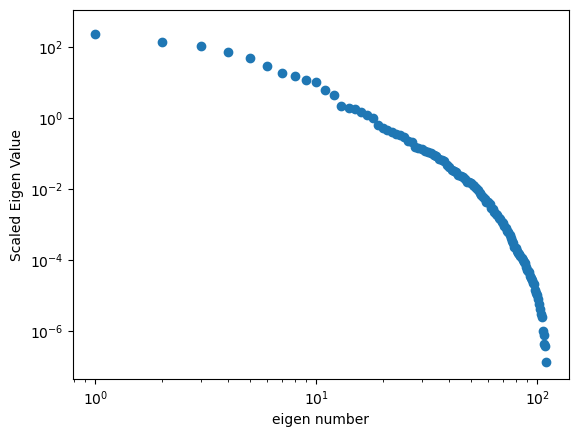

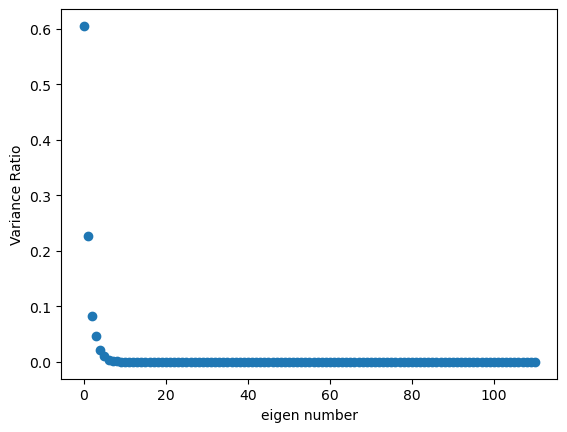

In [218]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [219]:
features_to_remove = {B*E3}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

,[A] [E1],[E1],[E2]^3,[B] [C] [D],[A] [C] [D]
[A],0.00000000,-0.00000000,-0.00000000,-0.00000000,0.00000000
[E1],-0.36488137,NaN,0.00000000,-0.00000000,-0.00000000
[B],0.00000000,-0.00000000,-0.00000000,0.00000000,0.00000000
[E2],-0.00000000,0.00000000,0.00000000,-0.00000000,-0.00000000
[C],-0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
[E3],-0.00000000,0.00000000,1.37636358,-0.00000000,-0.00000000
[D],-0.00000000,0.00000000,0.00000000,0.00000000,-0.00000000
[A]^2,0.00000000,-0.00000000,-0.00000000,-0.00000000,0.00000000
[A] [B],0.00000000,-0.00000000,-0.00000000,0.00000000,0.00000000
[A] [E2],0.00000000,-0.00000000,-0.00000000,-0.00000000,0.00000000


Text(0, 0.5, 'Variance Ratio')

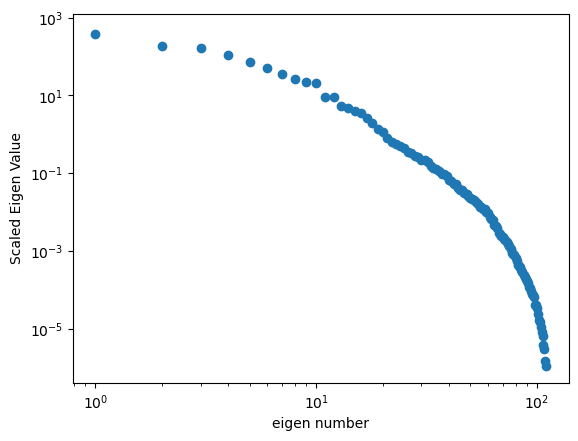

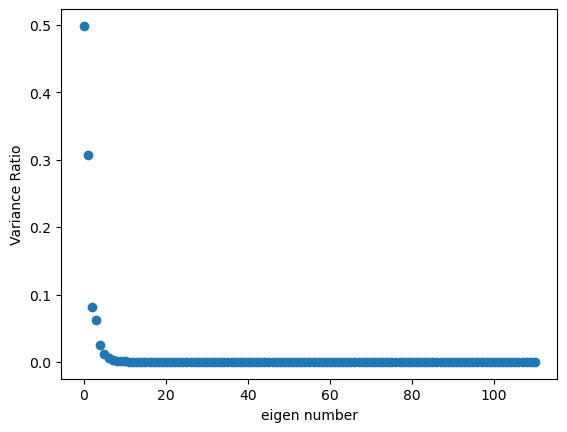

In [207]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [208]:
features_to_remove = {B**2 * E2}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

,[B] [E3],[E3],[B] [C] [D],[A] [C] [D],[A] [E1]
[A],0.00000000,-0.00000000,-0.00000000,0.00000000,0.00000000
[E1],-0.00000000,0.00000000,-0.00000000,-0.00000000,-0.52277652
[B],0.00000000,-0.00000000,0.00000000,0.00000000,0.00000000
[E2],-0.00000000,0.00000000,-0.00000000,-0.00000000,-0.00000000
[C],0.00000000,-0.00000000,0.00000000,0.00000000,-0.00000000
[E3],-0.62518953,NaN,-0.00000000,-0.00000000,-0.00000000
[D],-0.00000000,0.00000000,0.00000000,0.00000000,-0.00000000
[A]^2,0.00000000,-0.00000000,-0.00000000,0.00000000,0.00000000
[A] [E1],0.00000000,-0.00000000,0.00000000,0.00000000,NaN
[A] [B],0.00000000,-0.00000000,0.00000000,0.00000000,0.00000000


In [ ]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
features_to_remove = {A*B*E2}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
features_to_remove = {B**2}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
features_to_remove = {E1**2}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
features_to_remove = {B*E2}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
features_to_remove = {A**2 * E1}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
features_to_remove = {A**2 * E2}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
features_to_remove = {A * E2}

features_to_remove, candidate_lib_lasso_r2 = get_refined_lib(features_to_remove, data_matrix_df,
                                                  candidate_lib_lasso_r2, get_dropped_feat=True)
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
scaled_data_smooth = pd.DataFrame(s_scaler.fit_transform(data_matrix_df_smooth_appended), columns=s_scaler.feature_names_in_)
if '1' in scaled_data_smooth.columns:
    scaled_cand_lib['1'] = 1

In [ ]:
candidate_lib_lasso_r2

In [ ]:
candidate_lib_lasso_r2.std()

In [ ]:
scaled_cand_lib = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)
if '1' in scaled_cand_lib.columns:
    scaled_cand_lib['1'] = 1

In [ ]:
from dae_finder import sequentialThLin
from sklearn.linear_model import Lasso

lasso_model = Lasso(alpha = .7, fit_intercept = True)

lasso_model.fit(scaled_cand_lib, scaled_data_smooth['d([C]) /dt'])

In [ ]:
lasso_model.score(scaled_cand_lib, scaled_data_smooth['d([C]) /dt'])

In [ ]:
final_dict = dict(zip(lasso_model.feature_names_in_, lasso_model.coef_))

In [ ]:
final_dict

In [ ]:
final_df = pd.DataFrame.from_dict(final_dict, orient='index', dtype=None, columns=None)

In [ ]:
plt.plot(data_matrix_df_smooth_appended['d([C]) /dt'], candidate_lib_lasso_r2["[E2]"])

In [ ]:
plt.plot(data_matrix_df_smooth_appended['d([C]) /dt'], candidate_lib_lasso_r2["[E2]^2"])

In [ ]:
for x in candidate_lib_lasso_r2:
    if 'B^2' in x:
        candidate_lib_lasso_r2 = candidate_lib_lasso_r2.drop(x, axis=1)

algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')


In [ ]:
for x in candidate_lib_lasso_r2:
    if 'A AE1' in x:
        candidate_lib_lasso_r2 = candidate_lib_lasso_r2.drop(x, axis=1)

algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:

scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')


In [ ]:
candidate_lib_lasso_r2

In [ ]:
for x in candidate_lib_lasso_r2:
    if 'A E2' in x:
        candidate_lib_lasso_r2 = candidate_lib_lasso_r2.drop(x, axis=1)
        
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
for x in candidate_lib_lasso_r2:
    if 'E2' in x:
        candidate_lib_lasso_r2 = candidate_lib_lasso_r2.drop(x, axis=1)
        
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
for x in candidate_lib_lasso_r2:
    if 'E1 C' in x:
        candidate_lib_lasso_r2 = candidate_lib_lasso_r2.drop(x, axis=1)
        
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
for x in candidate_lib_lasso_r2:
    if 'E1' in x:
        candidate_lib_lasso_r2 = candidate_lib_lasso_r2.drop(x, axis=1)
        
algebraic_model_1.fit(candidate_lib_lasso_r2, scale_columns= True)
algebraic_model_1.best_models(5)

In [ ]:
scaled_cand_lib_lasso_r2 = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_r2), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_r2)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
from dae_finder import sequentialThLin
from sklearn.linear_model import Lasso

seq_th_model = sequentialThLin(fit_intercept = True)

seq_th_model.fit(X=candidate_lib_lasso_r2[0:415], y = selected_derr_data_matrix_df['d(C) /dt'])

In [ ]:
lasso_model = Lasso(alpha = .3, fit_intercept = True)

trial_set = candidate_lib_lasso_r2

for x in candidate_lib_lasso_r2:
    if 'C' in x:
        trial_set.drop(x, axis = 1, inplace = True)
        
lasso_model.fit(trial_set[0:415], selected_derr_data_matrix_df['d(C) /dt'])

In [ ]:

candidate_lib_lasso_r2

In [ ]:
selected_derr_data_matrix_df

In [ ]:
from dae_finder import sequentialThLin
from sklearn.linear_model import Lasso

lasso_model = Lasso(alpha = .1, fit_intercept = True)

lasso_model.fit(candidate_lib_lasso_r2[0:415], selected_derr_data_matrix_df['d(C) /dt'])

In [ ]:
lasso_model.score(candidate_lib_lasso_r2[0:415], selected_derr_data_matrix_df['d(C) /dt'])

In [ ]:
dict(zip(lasso_model.feature_names_in_, lasso_model.coef_))

In [ ]:
dict(zip(seq_th_model.feature_names_in_, seq_th_model.coef_))

In [ ]:
poly_feature_ob = PolyFeatureMatrix(2)
algebraic_model_1 = AlgModelFinder(fit_intercept = False)

candidate_lib_lasso_mse = poly_feature_ob.fit_transform(candidate_lib_lasso_r2)

candidate_lib_lasso_mse = candidate_lib_lasso_r2.sample(frac=1).reset_index(drop=True)

In [ ]:
candidate_lib_lasso_mse = poly_feature_ob.fit_transform(candidate_lib_lasso_r2)

candidate_lib_lasso_mse = candidate_lib_lasso_r2.sample(frac=1).reset_index(drop=True)


algebraic_model_1.fit(candidate_lib_lasso_mse, scale_columns= True)
algebraic_model_1.best_models(5, X_test = candidate_lib_test, metric = 'mse')

In [ ]:
scaled_cand_lib_lasso_mse = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_mse), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_mse)

plt.figure(1)
plt.loglog(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
for x in candidate_lib_lasso_mse:
    if 'BE2' in x:
        candidate_lib_lasso_mse = candidate_lib_lasso_mse.drop(x, axis=1)

algebraic_model_1.fit(candidate_lib_lasso_mse, scale_columns= True)
algebraic_model_1.best_models(5, X_test = candidate_lib_test, metric = 'mse')

In [ ]:
scaled_cand_lib_lasso_mse = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_mse), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_mse)

plt.figure(1)
plt.plot(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
candidate_lib_lasso_mse = candidate_lib_lasso_mse.drop('B E2', axis=1)

algebraic_model_1.fit(candidate_lib_lasso_mse, scale_columns= True)
algebraic_model_1.best_models(5, X_test = candidate_lib_test, metric = 'mse')

In [ ]:
scaled_cand_lib_lasso_mse = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_mse), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_mse)

plt.figure(1)
plt.plot(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
candidate_lib_lasso_mse = candidate_lib_lasso_mse.drop('E2 BE2', axis=1)

algebraic_model_1.fit(candidate_lib_lasso_mse, scale_columns= True)
algebraic_model_1.best_models(5, X_test = candidate_lib_test, metric = 'mse')

In [ ]:
scaled_cand_lib_lasso_mse = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_mse), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_mse)

plt.figure(1)
plt.plot(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
candidate_lib_lasso_mse = candidate_lib_lasso_mse.drop('BE2', axis=1)

algebraic_model_1.fit(candidate_lib_lasso_mse, scale_columns= True)
algebraic_model_1.best_models(5, X_test = candidate_lib_test, metric = 'mse')

In [ ]:
scaled_cand_lib_lasso_mse = pd.DataFrame(s_scaler.fit_transform(candidate_lib_lasso_mse), columns=s_scaler.feature_names_in_)

pca_2 = decomposition.PCA()
pca_2.fit(scaled_cand_lib_lasso_mse)

plt.figure(1)
plt.plot(pca_2.singular_values_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Scaled Eigen Value')
plt.figure(2)
plt.plot(pca_2.explained_variance_ratio_, 'o')
plt.xlabel('eigen number')
plt.ylabel('Variance Ratio')

In [ ]:
algebraic_model_1.best_models(X_test=candidate_lib_test, metric="mse")

In [ ]:
pca_2

In [ ]:
null_terms_comb = set()

for ind in alg_rel_df:
    if ind == len(alg_rel_df)-2:
        continue
    null_terms = alg_rel_df[ind][abs(alg_rel_df[ind])>thresh].index
    if '1' in null_terms:
        null_terms = null_terms.drop('1')
    if null_terms.empty:
        continue
    print("null terms selected for fitting are: {}".format(set(null_terms)))
    null_terms_comb = null_terms_comb.union(set(null_terms))
   
    scaled_cand_lib_restricted = scaled_cand_lib[null_terms]
    # print(scaled_cand_lib_restricted)
    
    # seq_model_1 = sequentialThLin(model_id="RR", alpha=0.05 , coef_threshold=0.2)
    
    # algebraic_model_Th = AlgModelFinder(custom_model= True, custom_model_ob= seq_model_1, fit_intercept=True)
    # algebraic_model_lasso = AlgModelFinder(custom_model=True, custom_model_ob=algebraic_model_Th_EN, fit_intercept=True)
    algebraic_model_Th_EN = AlgModelFinder(custom_model= True, custom_model_ob= seq_model_2, fit_intercept=True)
    
    algebraic_model_Th_EN.fit(scaled_cand_lib_restricted, scale_columns= True)
    print(algebraic_model_Th_EN.best_models())

In [ ]:
algebraic_model_2 = AlgModelFinder()

algebraic_model_2.fit(candidate_lib, scale_columns= True)

In [ ]:
algebraic_model_2.best_models()

In [ ]:
candidate_lib_E2 = candidate_lib.drop('E2', axis=1)

In [ ]:
candidate_lib

In [ ]:
algebraic_model_2.fit(candidate_lib_E2, scale_columns= True)
algebraic_model_2.best_models()

In [ ]:
candidate_A_E1 = candidate_lib_E2.drop('A E1', axis=1)

algebraic_model_2.fit(candidate_A_E1, scale_columns= True)
algebraic_model_2.best_models()

In [ ]:
candidate_BE2 = candidate_A_E1.drop('BE2', axis=1)

algebraic_model_2.fit(candidate_BE2, scale_columns= True)
algebraic_model_2.best_models()

In [ ]:
candidate_CE2 = candidate_BE2.drop('E2 C', axis=1)

algebraic_model_2.fit(candidate_CE2, scale_columns= True)
algebraic_model_2.best_models()

### Testing

In [ ]:
candidate_lib_lasso_r2